In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp
from scipy import stats
import math
from scipy.stats import chi2_contingency
from sklearn.feature_selection import mutual_info_classif



In [3]:
diab_df=pd.read_csv('/Users/vladandreichuk/Desktop/git_reps/Comparative-Analysis-of-ML-Algorithms-Predicting-Hospital-Readmission-of-Diabetes-Patients/diabetic_data.csv')

In [3]:
diab_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 50 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   encounter_id              101766 non-null  int64 
 1   patient_nbr               101766 non-null  int64 
 2   race                      101766 non-null  object
 3   gender                    101766 non-null  object
 4   age                       101766 non-null  object
 5   weight                    101766 non-null  object
 6   admission_type_id         101766 non-null  int64 
 7   discharge_disposition_id  101766 non-null  int64 
 8   admission_source_id       101766 non-null  int64 
 9   time_in_hospital          101766 non-null  int64 
 10  payer_code                101766 non-null  object
 11  medical_specialty         101766 non-null  object
 12  num_lab_procedures        101766 non-null  int64 
 13  num_procedures            101766 non-null  int64 
 14  num_

In [4]:
diab_df.columns

Index(['encounter_id', 'patient_nbr', 'race', 'gender', 'age', 'weight',
       'admission_type_id', 'discharge_disposition_id', 'admission_source_id',
       'time_in_hospital', 'payer_code', 'medical_specialty',
       'num_lab_procedures', 'num_procedures', 'num_medications',
       'number_outpatient', 'number_emergency', 'number_inpatient', 'diag_1',
       'diag_2', 'diag_3', 'number_diagnoses', 'max_glu_serum', 'A1Cresult',
       'metformin', 'repaglinide', 'nateglinide', 'chlorpropamide',
       'glimepiride', 'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone',
       'tolazamide', 'examide', 'citoglipton', 'insulin',
       'glyburide-metformin', 'glipizide-metformin',
       'glimepiride-pioglitazone', 'metformin-rosiglitazone',
       'metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted'],
      dtype='object')

In [5]:
def pie_chart(df, column_name, title):
    """
    This function creates a pie chart to visualize the distribution of categories in the specified DataFrame column.
    It uses Plotly Express to generate an interactive pie chart with labeled sections.

    Parameters:
        df (DataFrame): The DataFrame containing the data.
        column_name (str): The name of the column for which the pie chart will be created.
        title (str): The title of the pie chart.
    """
    counts = df[column_name].value_counts()
    fig = px.pie(counts, names=counts.index, values=counts.values, labels='counts')

    # Customize the layout
    fig.update_layout(
        title=title,
        title_x=0.51,  # Adjust the title's x-position to be centered
        title_y=0.95,  # Adjust the title's y-position to be just above the pie chart
        title_font=dict(size=18),  # Adjust title font size
        legend=dict(
            x=0.77,  # Adjust the x-position of the legend
            y=0.9,  # Adjust the y-position of the legend
        ),
    )

    fig.show()

In [6]:
def hist_ci_mean_med(df, column_name):
    """
    This function generates a histogram to visualize the distribution of values in the specified DataFrame column.
    The histogram includes vertical lines for the mean and median, as well as a shaded region indicating the 95% CI.

    Parameters:
        df (DataFrame): The DataFrame containing the data.
        column_name (str): The name of the column for which the histogram and statistics will be generated.
    """
    # Set the seaborn style and color palette
    sns.set_style("whitegrid")
    sns.set_palette("pastel")

    # Create a histogram of the specified column
    plt.figure(figsize=(10, 6))
    n, bins, _ = plt.hist(df[column_name], bins=30, alpha=0.7, edgecolor='black')

    # Calculate mean, median, and 95% confidence interval
    mean_value, median_value = np.mean(df[column_name]), np.median(df[column_name])
    conf_interval = stats.norm.interval(0.95, loc=mean_value, scale=df[column_name].std())

    # Add vertical lines with labels
    plt.axvline(x=mean_value, color='black', linestyle='--', linewidth=2, label='Mean')
    plt.axvline(x=median_value, color='green', linestyle='--', linewidth=2, label='Median')
    plt.axvline(x=conf_interval[0], color='red', linestyle='--', linewidth=2, label='95% CI (Lower Bound)')
    plt.axvline(x=conf_interval[1], color='red', linestyle='--', linewidth=2, label='95% CI (Upper Bound)')

    # Add legend
    plt.legend()

    # Customize labels and title
    plt.xlabel(column_name)
    plt.ylabel('Count')
    plt.title(f'Distribution of {column_name}')

    # Show the histogram
    plt.show()






In [7]:
def readmitted_by_feature(metric):
    """
    This function groups the data by the specified 'metric' and 'readmitted' status, calculates the percentage of readmitted patients for each category, and creates a bar plot using Plotly Express.
    The resulting plot displays the distribution of readmission percentages across categories of the specified 'metric,' providing insights into how different factors may affect patient readmission rates.

    Parameters:
        metric (str): The name of the feature (column) used for grouping data and creating the bar plot.
    """
    # Group the data by 'metric' and 'readmitted', and calculate the count for each combination
    grouped_data = diab_df.groupby([metric, 'readmitted']).size().unstack()

    # Calculate the percentage of readmitted patients for each category
    total_counts = grouped_data.sum(axis=1)
    for col in grouped_data.columns:
        grouped_data[col] = (grouped_data[col] / total_counts) * 100

    # Calculate the sum of percentages in '<30' and '>30' categories and sort by it
    grouped_data['sum_percentages'] = grouped_data['<30'] + grouped_data['>30']
    grouped_data = grouped_data.sort_values(by='sum_percentages', ascending=True)
    grouped_data.drop(columns='sum_percentages', inplace=True)

    # Create a DataFrame for Plotly
    grouped_data_reset = grouped_data.reset_index()

    # Create the bar plot using Plotly
    fig = px.bar(grouped_data_reset, x=metric, y=['<30', '>30', 'NO'], barmode='relative',
                 labels={metric: metric, 'value': 'Percentage'},
                 color_discrete_sequence=px.colors.qualitative.Pastel,
                 title=f'Readmission Patient Percentage by {metric}')

    # Customize the plot layout
    fig.update_layout(xaxis_title=metric, yaxis_title='Percentage', legend_title_text='Readmission Category')

    # Display the plot
    fig.show()

In [8]:
def time_in_hosp_by_feature(data, x_col, y_col='time_in_hospital'):
    """
    Create a set of boxplots for the 'y_col' variable for each category in the 'x_col' column.

    Parameters:
        data (DataFrame): The DataFrame containing the data.
        x_col (str): The name of the categorical column.
        y_col (str, optional): The name of the continuous variable for which boxplots are created. Default is 'time_in_hospital'.
    """
    fig = px.box(data_frame=data, x=x_col, y=y_col, title=f'Distribution of {y_col} by {x_col}')
    fig.update_xaxes(tickangle=45)
    fig.show()

In [9]:
def boxplot_num_vars(df, columns, names, show_percentages):
    """
    This function generates a set of subplots with boxplots for the specified columns, each subplot labeled with the provided titles.
    
    Parameters:
        df (DataFrame): The DataFrame containing the data.
        columns (list): A list of column names to create boxplots for.
        names (list): A list of titles for the boxplots.
        show_percentages (bool, optional): If True, display the percentage of outliers next to each boxplot. Default is False.
    """
    # Create subplots
    fig = sp.make_subplots(rows=2, cols=4, subplot_titles=names, vertical_spacing=0.1)

    # Create boxplots for each column
    for i, column in enumerate(columns):
        row = i // 4 + 1
        col = i % 4 + 1

        # Calculate Z-scores for the current column
        z_scores = stats.zscore(df[column])

        # Identify outliers based on Z-scores
        outliers = (z_scores > 3) | (z_scores < -3)  # You can adjust the threshold if needed

        # Compute the percentage of outliers
        percentage_outliers = (sum(outliers) / len(df)) * 100

        # Create the subtitle with or without the percentage of outliers
        if show_percentages==True:
            fig.layout.annotations[i].update(text=f'{names[i]} (Outliers: {percentage_outliers:.2f}%)')


        trace = go.Box(y=df[column], name=names[i], boxmean=True, orientation='v')
        fig.add_trace(trace, row=row, col=col)

        # Remove y-axis tick labels
        fig.update_xaxes(showticklabels=False, row=row, col=col)

    # Update layout
    fig.update_layout(
        title="Distributions of Numerical Variables",
        showlegend=False
    )

    # Show the plot
    fig.show()

In [7]:
# Plot the distribution of patients by race
fig = px.histogram(diab_df, x='race', title='Race Distribution')
fig.update_xaxes(title='Race Distribution')
fig.update_yaxes(title='Count')
fig.show()

In [10]:
# Create pie chart for 'race'
pie_chart(diab_df, 'race', 'Race Distribution')

In [8]:
# Plot the distribution of patients by gender
fig = px.histogram(diab_df, x='gender', title='Gender Distribution')
fig.update_xaxes(title='Gender Distribution')
fig.update_yaxes(title='Count')
fig.show()

In [11]:
# Create pie chart for 'gender'
pie_chart(diab_df, 'gender', 'Gender Distribution')

In [12]:
# Plot age distribution of patients by age
fig = px.histogram(diab_df, x='age', title='Age Distribution')
fig.update_xaxes(title='Age Distribution')
fig.update_yaxes(title='Count')
fig.show()

In [13]:
# Plot the proportions of readmitted patients in each race
readmitted_by_feature(metric='race')

In [14]:
# Plot the proportions of readmitted patients in each gender
readmitted_by_feature(metric='gender')

In [15]:
# Plot the proportions of readmitted patients in each age
readmitted_by_feature(metric='age')

In [3]:
from scipy.stats import chi2_contingency

# Create a contingency table
contingency_table = pd.crosstab(diab_df['age'], diab_df['readmitted'])

# Perform the chi-squared test
chi2, p, _, _ = chi2_contingency(contingency_table)

# Calculate Cramér's V
n = contingency_table.sum().sum()
k, r = contingency_table.shape
cramer_v = np.sqrt(chi2 / (n * min(k-1, r-1)))

# Output the results
print(f"Chi-squared value: {chi2}")
print(f"P-value: {p}")
print(f"Cramér's V: {cramer_v}")

# Check significance (assuming a significance level of 0.05)
if p < 0.05:
    print("The association between age and readmission is statistically significant.")
else:
    print("There is no significant association between age and readmission.")

Chi-squared value: 313.17175286517806
P-value: 9.348415309480624e-56
Cramér's V: 0.03922608286632052
The association between age and readmission is statistically significant.


In [16]:
# Plot the proportions of readmitted patients in each 'diabetesMed' category
readmitted_by_feature(metric='diabetesMed')

In [17]:
# Plor the distrivuton of time spent in the hospital by patients of different races
fig = px.box(data_frame=diab_df, x='race', y='time_in_hospital', title=f'Distribution of time_in_hospital by race')
fig.update_xaxes(tickangle=45)
fig.update_layout(yaxis_title='Time in the hospital (days)')
fig.show()

In [4]:
# Plot the distribution of age of patients of different races
fig = px.box(data_frame=diab_df, x='race', y='age', title=f'Distribution of age by race')
fig.update_xaxes(tickangle=45)
fig.update_layout(yaxis_title='Age (years old)')
fig.show()

In [10]:
from scipy.stats import f_oneway

# Extract data for 'Asian', 'Hispanic', and other races
asian_days = diab_df[diab_df['race'] == 'Asian']['time_in_hospital']
hispanic_days = diab_df[diab_df['race'] == 'Hispanic']['time_in_hospital']
other_days = diab_df[~diab_df['race'].isin(['Asian', 'Hispanic'])]['time_in_hospital']

# Perform ANOVA test
f_stat, p_value = f_oneway(asian_days, hispanic_days, other_days)

# Output the results
print(f"F-statistic: {f_stat}")
print(f"P-value: {p_value}")

# Check significance (assuming a significance level of 0.05)
if p_value < 0.05:
    print("There is a significant difference in the number of days spent in the hospital among the races.")
else:
    print("There is no significant difference in the number of days spent in the hospital among the races.")

F-statistic: 19.193896648701052
P-value: 4.6319989336980455e-09
There is a significant difference in the number of days spent in the hospital among the races.


In [18]:
# Plot the distribution of time spent in the hospital by patients of different genders
fig = px.box(data_frame=diab_df, x='gender', y='time_in_hospital', title=f'Distribution of time_in_hospital by gender')
fig.update_xaxes(tickangle=45)
fig.update_layout(yaxis_title='Time in the hospital (days)')
fig.show()

In [19]:
# Plot the distribution of time spent in the hospital by patients of different ages
fig = px.box(data_frame=diab_df, x='age', y='time_in_hospital', title=f'Distribution of time_in_hospital by age')
fig.update_xaxes(tickangle=45)
fig.update_layout(yaxis_title='Time in the hospital (days)')
fig.show()

In [13]:
from scipy.stats import kruskal
from mpmath import mp

# Perform Kruskal-Wallis H-test with mpmath precision
mp.dps = 0.00000000000000001

# Perform Kruskal-Wallis H-test
h_stat, p_value = kruskal(*[diab_df[diab_df['age'] == age_group]['time_in_hospital'] for age_group in diab_df['age'].unique()])

# Output the results
print(f"Kruskal-Wallis H-statistic: {h_stat}")
print(f"P-value: {mp.nstr(p_value)}")

# Check significance (assuming a significance level of 0.05)
if p_value < 0.05:
    print("There is a significant difference in time spent in the hospital among age groups.")
else:
    print("There is no significant difference in time spent in the hospital among age groups.")


Kruskal-Wallis H-statistic: 1582.7185295987488
P-value: 0.0
There is a significant difference in time spent in the hospital among age groups.


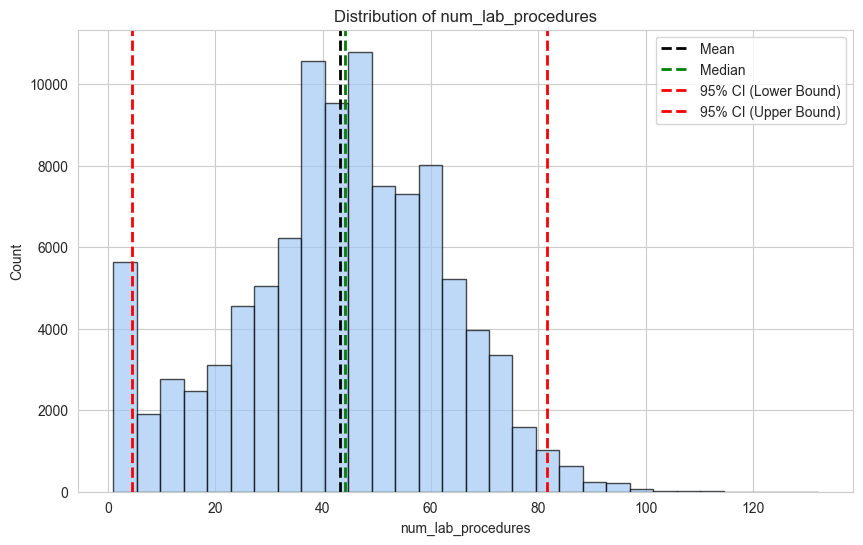

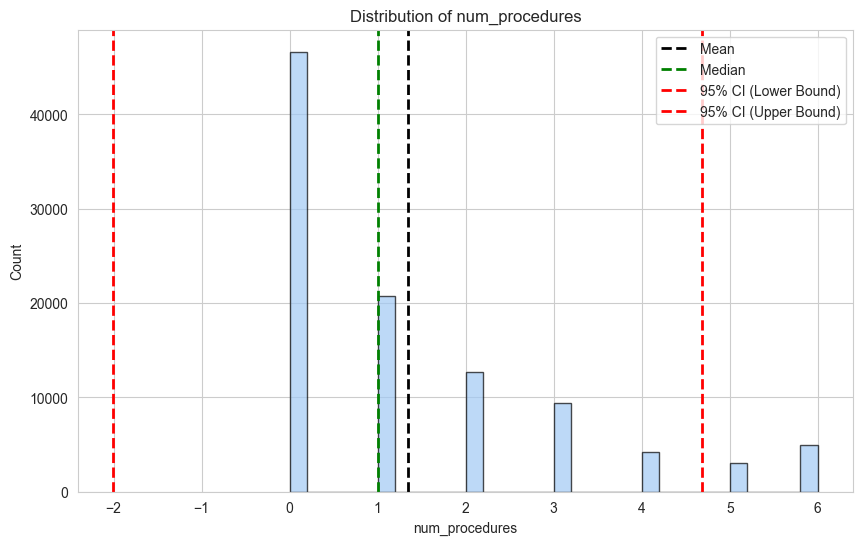

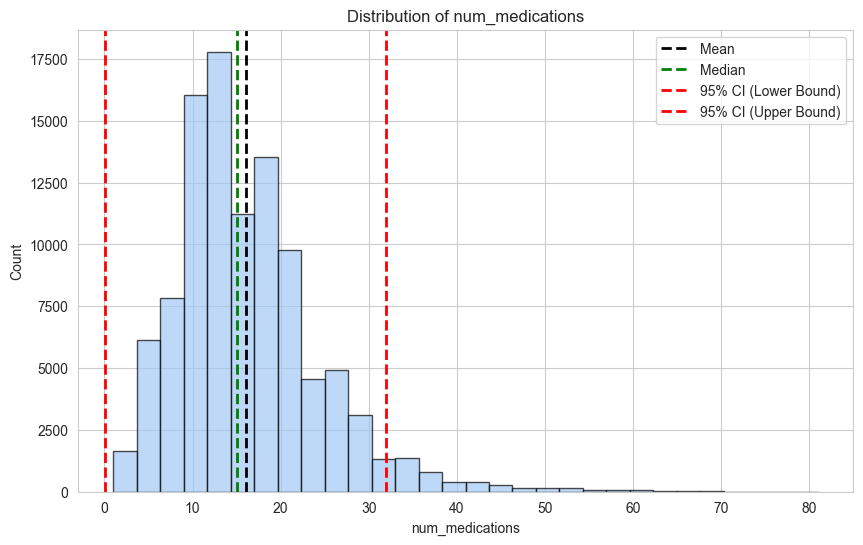

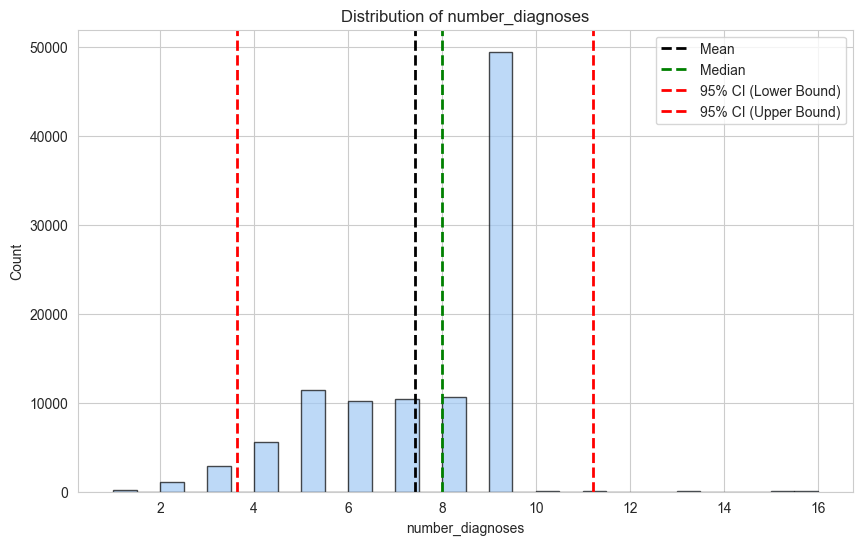

In [20]:
# Histograms showing distribution of numerical variables
hist_ci_mean_med(diab_df, 'num_lab_procedures')
hist_ci_mean_med(diab_df, 'num_procedures')
hist_ci_mean_med(diab_df, 'num_medications')
hist_ci_mean_med(diab_df, 'number_diagnoses')

In [21]:
# Define the columns of interest and corresponding names
columns_of_interest = ['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications',
                        'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses']
names = ['Time in Hospital (Days)', 'Lab Procedures', 'Procedures', 'Medications',
         'Outpatient Visits', 'Emergency Room Visits', 'Inpatient Visits', 'Diagnoses']

# Create subplots
boxplot_num_vars(diab_df, columns_of_interest, names,show_percentages=False)

In [22]:
# Boxplot of time_in_hospital across values in diabetesMed and readmitted
fig = px.box(diab_df, x='time_in_hospital', color='readmitted', y='diabetesMed',
             category_orders = {'readmitted':['NO', '<30', '>30']})
fig.update_layout(
    title="Time Spent in the Hospital for Patients with Different Readmittance and Diabetes Medication Intake")
fig.show()

In [23]:
# Histogram of time_in_hospital across values in diabetesMed 
fig = px.histogram(diab_df, x='time_in_hospital', color='diabetesMed')
fig.update_layout(
    title="Distribution of the Time Spent in the Hospital for Patients with Different Diabetes Medication Intake",
    yaxis_title='Number of Patients')
fig.show()

In [15]:
# Calculate relative percentages
percentage_df = diab_df.groupby(['time_in_hospital', 'diabetesMed']).size().reset_index(name='count')
percentage_df['percentage'] = percentage_df.groupby('diabetesMed')['count'].transform(lambda x: x / x.sum() * 100)

# Histogram of time_in_hospital across values in diabetesMed
fig = px.bar(
    percentage_df,
    x='time_in_hospital',
    y='percentage',
    color='diabetesMed',
    barmode='stack',  # Stack bars for better comparison
    title="Distribution of the Time Spent in the Hospital for Patients with Different Diabetes Medication Intake",
    labels={'time_in_hospital': 'Time in Hospital', 'percentage': 'Percentage'},
    height=500
)

fig.update_yaxes(title_text='Percentage of Patients')
fig.show()

In [16]:
# Calculate relative percentages
percentage_df = diab_df.groupby(['time_in_hospital', 'diabetesMed']).size().reset_index(name='count')
percentage_df['percentage'] = percentage_df.groupby('diabetesMed')['count'].transform(lambda x: x / x.sum() * 100)

# Histogram of time_in_hospital across values in diabetesMed
fig = px.bar(
    percentage_df,
    x='time_in_hospital',
    y='percentage',
    color='diabetesMed',
    facet_col='diabetesMed',  # Use facet_col to display classes side by side
    title="Distribution of the Time Spent in the Hospital for Patients with Different Diabetes Medication Intake",
    labels={'time_in_hospital': 'Time in Hospital', 'percentage': 'Percentage'},
    height=500
)

fig.update_yaxes(title_text='Percentage of Patients')
fig.show()

In [24]:
# Histogram of time_in_hospital across values in readmitted
fig = px.histogram(diab_df, x='time_in_hospital', color='readmitted',
             category_orders = {'readmitted':['NO', '<30', '>30']})
fig.update_layout(
    title="Distribution of the Time Spent in the Hospital for Patients with Different Readmittance",
    yaxis_title='Number of Patients')
fig.show()

In [17]:
# Calculate relative percentages
percentage_df = diab_df.groupby(['time_in_hospital', 'readmitted']).size().reset_index(name='count')
percentage_df['percentage'] = percentage_df.groupby('readmitted')['count'].transform(lambda x: x / x.sum() * 100)

# Histogram of time_in_hospital across values in diabetesMed
fig = px.bar(
    percentage_df,
    x='time_in_hospital',
    y='percentage',
    color='readmitted',
    facet_col='readmitted',  # Use facet_col to display classes side by side
    title="Distribution of the Time Spent in the Hospital for Patients with Different Readmittance",
    labels={'time_in_hospital': 'Time in Hospital', 'percentage': 'Percentage'},
    height=500
)

fig.update_yaxes(title_text='Percentage of Patients')
fig.show()